<a href="https://colab.research.google.com/github/pandeyshishir/Course/blob/master/Assignment-2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# First thing we do is import all required items - up to basic linear regression
# we will come back and add stuff for cross validation and advanced regression stuff.

import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt 
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LinearRegression
import sklearn.metrics as metrics
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
import scipy.stats as stats
from sklearn.linear_model import Ridge, RidgeCV, Lasso, LassoCV
from sklearn.metrics import mean_squared_error

In [ ]:
# Read the data we are going to work with.
original_data = pd.read_csv("./train.csv")

In [ ]:
original_data.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


In [ ]:
# We can see that there are a few NaN columns, so let us first find those columns. 
# and also find the % of such null/NaN values across columns
original_data[original_data.columns[original_data.isnull().any()]].isnull().sum() * 100 / original_data.shape[0]

LotFrontage     17.739726
Alley           93.767123
MasVnrType       0.547945
MasVnrArea       0.547945
BsmtQual         2.534247
BsmtCond         2.534247
BsmtExposure     2.602740
BsmtFinType1     2.534247
BsmtFinType2     2.602740
Electrical       0.068493
FireplaceQu     47.260274
GarageType       5.547945
GarageYrBlt      5.547945
GarageFinish     5.547945
GarageQual       5.547945
GarageCond       5.547945
PoolQC          99.520548
Fence           80.753425
MiscFeature     96.301370
dtype: float64

In [ ]:
# We can see that there are at least 6 columns where % of null/nan values > 30%, so we can't do any sort of interpolation.
# Hence we'll drop those columns. 
non_null_data = original_data.dropna(thresh=len(original_data)*(0.7), axis=1)
#Now let us look at what data has been dropped and what is the new shape of the data.
print(non_null_data.shape)

non_null_data.head()

(1460, 76)


,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,...,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,Reg,Lvl,AllPub,Inside,...,0,0,0,0,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,Reg,Lvl,AllPub,FR2,...,0,0,0,0,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,IR1,Lvl,AllPub,Inside,...,0,0,0,0,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,IR1,Lvl,AllPub,Corner,...,272,0,0,0,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,IR1,Lvl,AllPub,FR2,...,0,0,0,0,0,12,2008,WD,Normal,250000


In [ ]:
# We know for a fact we do not need the "Id" column, so let us drop it.
non_null_data.drop('Id', axis=1, inplace=True)
non_null_data.shape


<ipython-input-8-d9f2e74f2bc1>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  non_null_data.drop('Id', axis=1, inplace=True)


(1460, 75)

In [ ]:
# For the remaining dataset let us first find if there is any column that contains a mixture of 
# numeric and non-numeric values.
number_and_non_number = [column_name for column_name in non_null_data.columns if pd.to_numeric(non_null_data[column_name], errors='coerce').isna().any() and pd.to_numeric(non_null_data[column_name], errors='coerce').notna().any()]
non_null_data[number_and_non_number].info()
nan_data = [(column_name, non_null_data.loc[non_null_data[column_name].apply(lambda x: isinstance(x, (str, bytes))), column_name].isna().any()) for column_name in number_and_non_number]
nan_data


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 3 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   LotFrontage  1201 non-null   float64
 1   MasVnrArea   1452 non-null   float64
 2   GarageYrBlt  1379 non-null   float64
dtypes: float64(3)
memory usage: 34.3 KB


[('LotFrontage', False), ('MasVnrArea', False), ('GarageYrBlt', False)]

In [ ]:
# So none of the three identified columns contain null or NaN data, which is surprising since 17% of LotFrontage 
# data has null or NaN values. So let us identify the unique non-numeric values from these 3 columns
unique_non_numeric_values = [(column_name, non_null_data.loc[non_null_data[column_name].apply(lambda x: isinstance(x, (str, bytes))), column_name].unique()) for column_name in number_and_non_number]
print(unique_non_numeric_values)

[('LotFrontage', array([], dtype=float64)), ('MasVnrArea', array([], dtype=float64)), ('GarageYrBlt', array([], dtype=float64))]


In [ ]:
non_null_data.dropna(axis=0, inplace=True)
non_null_data.shape
number_and_non_number = [column_name for column_name in non_null_data.columns if pd.to_numeric(non_null_data[column_name], errors='coerce').isna().any() and pd.to_numeric(non_null_data[column_name], errors='coerce').notna().any()]
non_null_data[number_and_non_number].info()
# So now we have no non-null values. so let us do a quick info on final data we'll work with
non_null_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1094 entries, 0 to 1459
Empty DataFrame
<class 'pandas.core.frame.DataFrame'>
Int64Index: 1094 entries, 0 to 1459
Data columns (total 75 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   MSSubClass     1094 non-null   int64  
 1   MSZoning       1094 non-null   object 
 2   LotFrontage    1094 non-null   float64
 3   LotArea        1094 non-null   int64  
 4   Street         1094 non-null   object 
 5   LotShape       1094 non-null   object 
 6   LandContour    1094 non-null   object 
 7   Utilities      1094 non-null   object 
 8   LotConfig      1094 non-null   object 
 9   LandSlope      1094 non-null   object 
 10  Neighborhood   1094 non-null   object 
 11  Condition1     1094 non-null   object 
 12  Condition2     1094 non-null   object 
 13  BldgType       1094 non-null   object 
 14  HouseStyle     1094 non-null   object 
 15  OverallQual    1094 non-null   int64  
 16  Overal

<ipython-input-12-2efba2bd79a4>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  non_null_data.dropna(axis=0, inplace=True)


In [ ]:
# So we have 1094 valid, non-null data this is the final set we'll work with. Before we start working however
# we will need to do something about the non-numeric columns. Let us first find all the non-numeric columns.
non_numeric_columns = non_null_data.select_dtypes(exclude=np.number)
non_numeric_columns

,MSZoning,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,...,Electrical,KitchenQual,Functional,GarageType,GarageFinish,GarageQual,GarageCond,PavedDrive,SaleType,SaleCondition
0,RL,Pave,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,...,SBrkr,Gd,Typ,Attchd,RFn,TA,TA,Y,WD,Normal
1,RL,Pave,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,...,SBrkr,TA,Typ,Attchd,RFn,TA,TA,Y,WD,Normal
2,RL,Pave,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,...,SBrkr,Gd,Typ,Attchd,RFn,TA,TA,Y,WD,Normal
3,RL,Pave,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,...,SBrkr,Gd,Typ,Detchd,Unf,TA,TA,Y,WD,Abnorml
4,RL,Pave,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,...,SBrkr,Gd,Typ,Attchd,RFn,TA,TA,Y,WD,Normal
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1455,RL,Pave,Reg,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,...,SBrkr,TA,Typ,Attchd,RFn,TA,TA,Y,WD,Normal
1456,RL,Pave,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,...,SBrkr,TA,Min1,Attchd,Unf,TA,TA,Y,WD,Normal
1457,RL,Pave,Reg,Lvl,AllPub,Inside,Gtl,Crawfor,Norm,Norm,...,SBrkr,Gd,Typ,Attchd,RFn,TA,TA,Y,WD,Normal
1458,RL,Pave,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,...,FuseA,Gd,Typ,Attchd,Unf,TA,TA,Y,WD,Normal


In [ ]:
# So we have 37 non-numeric columns, now let us look at all the unique values that each of these columns contains and
# The number of unique values must be > 1 because if all values are same it has no impact on target variable. 
unique_values = {col: non_numeric_columns[col].unique() for col in non_numeric_columns if len(non_numeric_columns[col].unique()) > 1}
print(unique_values)

# Get column names as list excluding columns with only one unique value
column_names = [col for col in non_numeric_columns.columns if len(non_numeric_columns[col].unique()) > 1]
print(column_names)

{'MSZoning': array(['RL', 'RM', 'C (all)', 'FV', 'RH'], dtype=object), 'Street': array(['Pave', 'Grvl'], dtype=object), 'LotShape': array(['Reg', 'IR1', 'IR2', 'IR3'], dtype=object), 'LandContour': array(['Lvl', 'Bnk', 'Low', 'HLS'], dtype=object), 'LotConfig': array(['Inside', 'FR2', 'Corner', 'CulDSac', 'FR3'], dtype=object), 'LandSlope': array(['Gtl', 'Mod', 'Sev'], dtype=object), 'Neighborhood': array(['CollgCr', 'Veenker', 'Crawfor', 'NoRidge', 'Mitchel', 'Somerst',
       'OldTown', 'BrkSide', 'Sawyer', 'NridgHt', 'SawyerW', 'NAmes',
       'IDOTRR', 'MeadowV', 'Timber', 'StoneBr', 'ClearCr', 'Gilbert',
       'Edwards', 'NWAmes', 'NPkVill', 'Blmngtn', 'BrDale', 'SWISU',
       'Blueste'], dtype=object), 'Condition1': array(['Norm', 'Feedr', 'Artery', 'RRAe', 'RRNn', 'RRAn', 'PosN', 'PosA',
       'RRNe'], dtype=object), 'Condition2': array(['Norm', 'Artery', 'RRNn', 'Feedr', 'PosN', 'PosA'], dtype=object), 'BldgType': array(['1Fam', '2fmCon', 'TwnhsE', 'Duplex', 'Twnhs'], dtype=

In [ ]:
#None of these values appear to be a grading value or presenting any sort of ordered set so we can't use LabelEncoding
# So let us use one-hot encoding on this set of data. But before we do one-hot encoding and generate correlation matrix
# Let us do one-way ANOVA and capture the results in an array of objects (we'll draw histograms)
# Perform one-way ANOVA for each non-numeric column and store the results in a list
anova_results = [(column, *stats.f_oneway(*[non_null_data.loc[non_null_data[column] == category, 'SalePrice'] for category in non_null_data[column].unique()])) for column in column_names]

# Print out the results
for column, f_statistic, p_value in anova_results:
    print(f"For column {column}, F-statistic = {f_statistic}, p-value = {p_value}")
anova_results

For column MSZoning, F-statistic = 33.780054525283134, p-value = 1.3413262974164305e-26
For column Street, F-statistic = 3.595439252168668, p-value = 0.0582020826862889
For column LotShape, F-statistic = 43.460918662908966, p-value = 1.5692381285198823e-26
For column LandContour, F-statistic = 10.275161357519506, p-value = 1.1305963723714347e-06
For column LotConfig, F-statistic = 11.056634084905095, p-value = 8.581295887163372e-09
For column LandSlope, F-statistic = 0.6966178499746266, p-value = 0.49848916319973924
For column Neighborhood, F-statistic = 54.11818401063051, p-value = 9.902414748887398e-166
For column Condition1, F-statistic = 4.243724447245936, p-value = 4.9588156925432366e-05
For column Condition2, F-statistic = 2.466450282589298, p-value = 0.031149064536427185
For column BldgType, F-statistic = 8.018281231339753, p-value = 2.2673857820103456e-06
For column HouseStyle, F-statistic = 14.83600218488389, p-value = 1.429246327014752e-18
For column RoofStyle, F-statistic = 

[('MSZoning', 33.780054525283134, 1.3413262974164305e-26),
 ('Street', 3.595439252168668, 0.0582020826862889),
 ('LotShape', 43.460918662908966, 1.5692381285198823e-26),
 ('LandContour', 10.275161357519506, 1.1305963723714347e-06),
 ('LotConfig', 11.056634084905095, 8.581295887163372e-09),
 ('LandSlope', 0.6966178499746266, 0.49848916319973924),
 ('Neighborhood', 54.11818401063051, 9.902414748887398e-166),
 ('Condition1', 4.243724447245936, 4.9588156925432366e-05),
 ('Condition2', 2.466450282589298, 0.031149064536427185),
 ('BldgType', 8.018281231339753, 2.2673857820103456e-06),
 ('HouseStyle', 14.83600218488389, 1.429246327014752e-18),
 ('RoofStyle', 20.705816958188393, 1.8309926657608824e-16),
 ('RoofMatl', 6.394609335207306, 1.2429509772550094e-06),
 ('Exterior1st', 18.307921974753704, 6.445202810272766e-39),
 ('Exterior2nd', 16.257377795366992, 1.0409550326597375e-38),
 ('MasVnrType', 88.22834175919137, 4.107499980506113e-51),
 ('ExterQual', 358.42172958898107, 6.505071633598856e-1

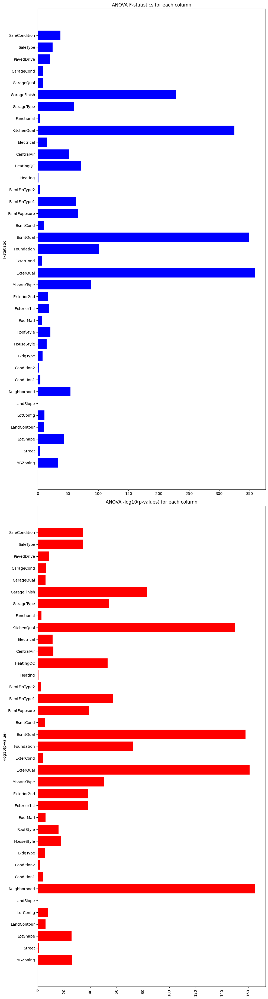

In [ ]:
# Let us try and plot the histogram 
# Create a separate list for columns, F-statistics, and p-values
columns = [result[0] for result in anova_results]
f_statistics = [result[1] for result in anova_results]
p_values = [-np.log10(result[2]) for result in anova_results]

# Create a new figure and two subplots (ax1 for F-statistics, ax2 for -log10(p-values))
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, len(columns)))

# Barh plot for F-statistics
ax1.barh(columns, f_statistics, color='blue')
ax1.set_ylabel('F-statistic')
ax1.set_title('ANOVA F-statistics for each column')
plt.xticks(rotation=90)

# Barh plot for -log10(p-values)
ax2.barh(columns, p_values, color='red')
ax2.set_ylabel('-log10(p-value)')
ax2.set_title('ANOVA -log10(p-values) for each column')
plt.xticks(rotation=90)

# Show the plot
plt.tight_layout()
plt.show()

In [ ]:
# While the bargraphs are nice, it seems like the only really low values for p-value are for the following four
# categories. Mostly because p-values are relatively high compared to others. Now one other way to do it 
# would be to apply ridge or lasso 
unaffecting_categories = ['Street', 'Heating', 'Condition2', 'LandSlope', 'BsmtFinType2'] 

In [ ]:
# Now we perform one-hot encoding, since none of the categorical variables are ordered variables by the looks of it. 
expanded_data = pd.get_dummies(non_null_data, columns=non_numeric_columns.columns)

In [ ]:
correlation_matrix = expanded_data.corr()

In [ ]:
plt.figure(figsize=(200, 180)) # Increase the size of the heatmap for better visibility
sns.heatmap(correlation_matrix, cmap='coolwarm', annot=True)

plt.title('Correlation matrix of the DataFrame')
plt.show()

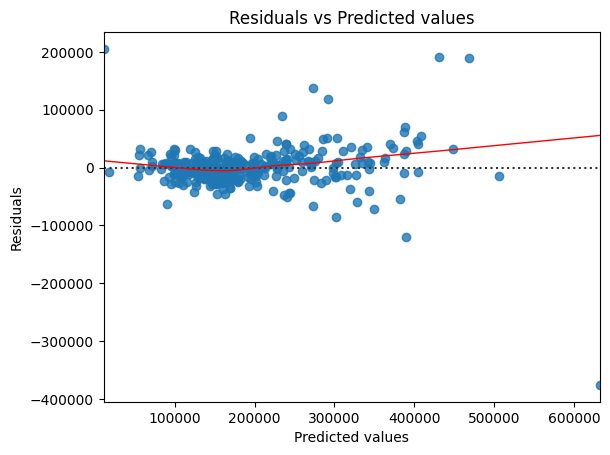

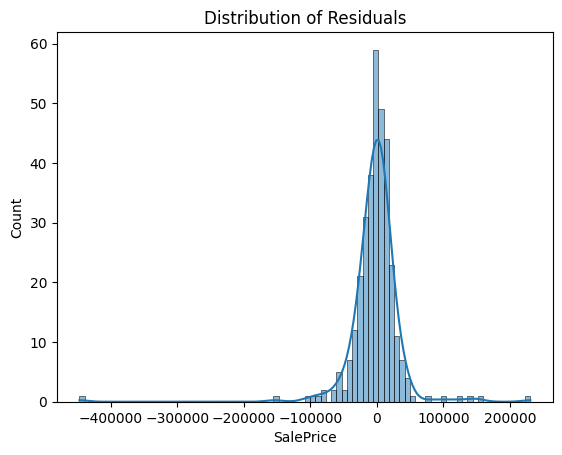

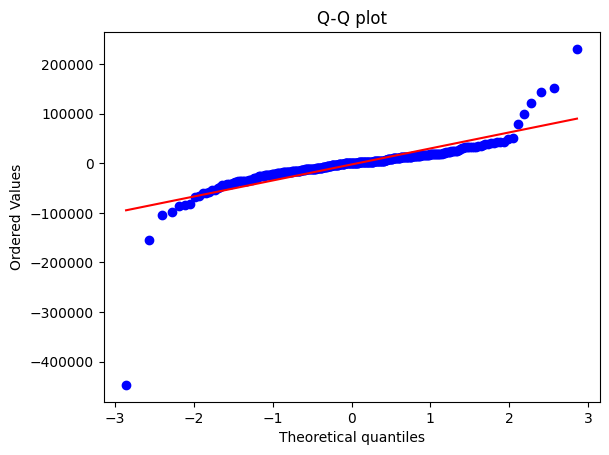

0.7709975040381407


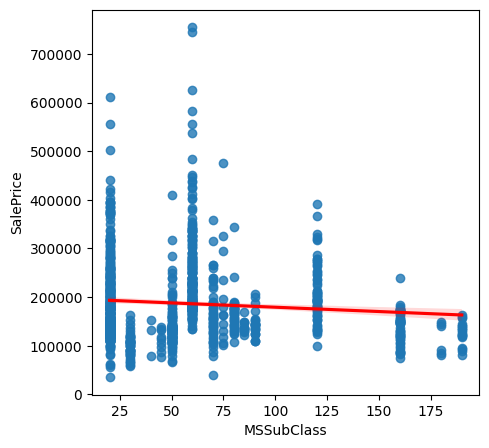

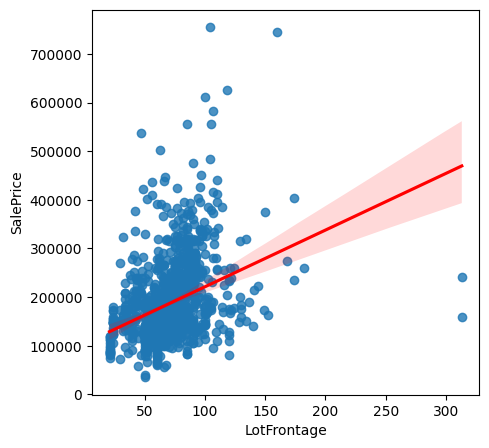

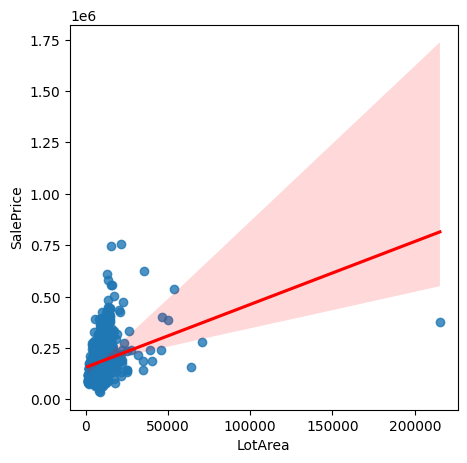

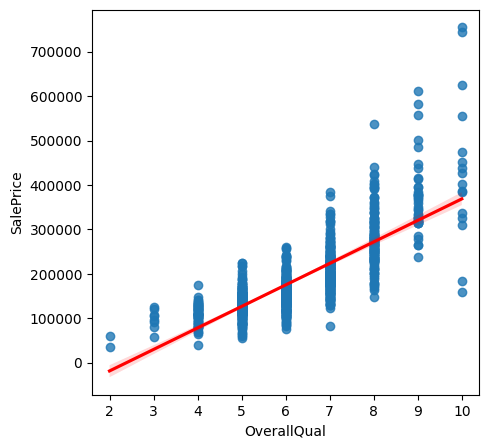

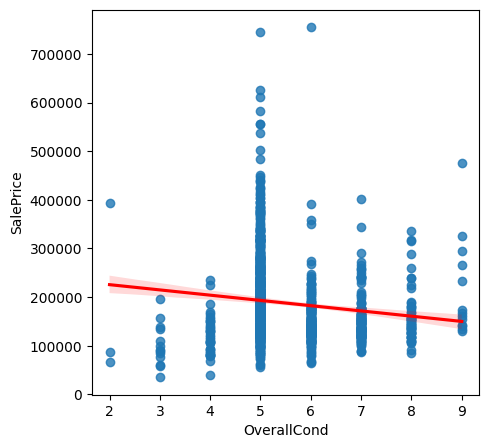

...

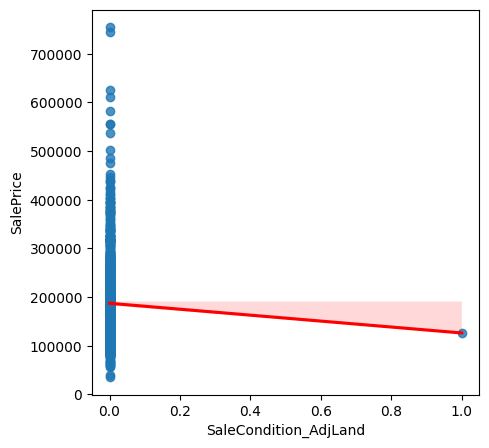

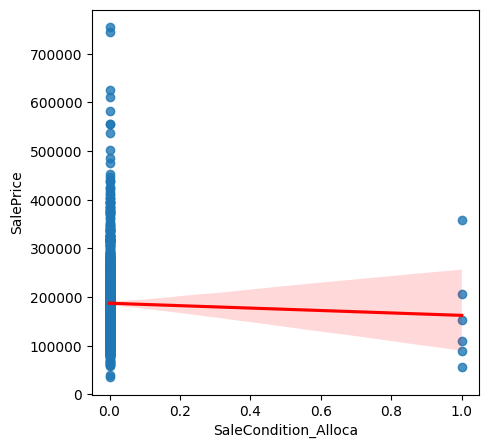

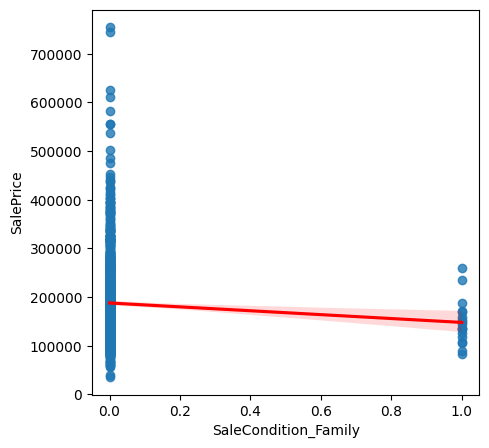

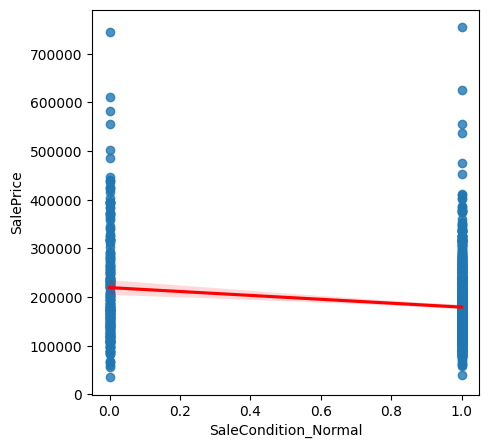

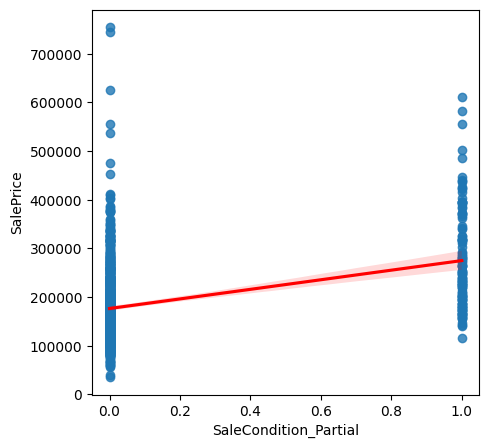

In [26]:
# Now let us perform linear regression 
LR = LinearRegression()
# First construct predictor variables (X) and target variables (Y)
X = expanded_data.drop('SalePrice', axis=1)
y = expanded_data['SalePrice']

# Split the training and test data (setting random state ensures we get same data, test size 0.3 means we are doing a 3:7 split)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=100)

# Train the model
LR.fit(X_train, y_train)

# Predict
y_pred = LR.predict(X_test)

# Now let us plot the residuals 
residuals = y_test - y_pred
sns.residplot(x=y_pred, y=residuals, lowess=True, line_kws={'color': 'red', 'lw': 1, 'alpha': 1})
plt.xlabel('Predicted values')
plt.ylabel('Residuals')
plt.title('Residuals vs Predicted values')
plt.show()

sns.histplot(residuals, kde=True)
plt.title('Distribution of Residuals')
plt.show()

# Q-Q plot
stats.probplot(residuals, dist="norm", plot=plt)
plt.title('Q-Q plot')
plt.show()

# First let us get the R^2 score for the model 
r2 = r2_score(y_test, y_pred)
print(r2)
# It doesn't seem like all assumptions of linear regression are satisfied so let us look at regplots 
for column in expanded_data.columns:
    plt.figure(figsize=(5,5))
    sns.regplot(x=column, y='SalePrice', data=expanded_data, line_kws={'color': 'red'})
    plt.show()

In [30]:
non_numeric_columns

,MSZoning,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,...,Electrical,KitchenQual,Functional,GarageType,GarageFinish,GarageQual,GarageCond,PavedDrive,SaleType,SaleCondition
0,RL,Pave,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,...,SBrkr,Gd,Typ,Attchd,RFn,TA,TA,Y,WD,Normal
1,RL,Pave,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,...,SBrkr,TA,Typ,Attchd,RFn,TA,TA,Y,WD,Normal
2,RL,Pave,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,...,SBrkr,Gd,Typ,Attchd,RFn,TA,TA,Y,WD,Normal
3,RL,Pave,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,...,SBrkr,Gd,Typ,Detchd,Unf,TA,TA,Y,WD,Abnorml
4,RL,Pave,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,...,SBrkr,Gd,Typ,Attchd,RFn,TA,TA,Y,WD,Normal
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1455,RL,Pave,Reg,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,...,SBrkr,TA,Typ,Attchd,RFn,TA,TA,Y,WD,Normal
1456,RL,Pave,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,...,SBrkr,TA,Min1,Attchd,Unf,TA,TA,Y,WD,Normal
1457,RL,Pave,Reg,Lvl,AllPub,Inside,Gtl,Crawfor,Norm,Norm,...,SBrkr,Gd,Typ,Attchd,RFn,TA,TA,Y,WD,Normal
1458,RL,Pave,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,...,FuseA,Gd,Typ,Attchd,Unf,TA,TA,Y,WD,Normal


In [41]:
column_names_to_drop = [col for col in non_numeric_columns.columns]
column_names_to_drop

['MSZoning',
 'Street',
 'LotShape',
 'LandContour',
 'Utilities',
 'LotConfig',
 'LandSlope',
 'Neighborhood',
 'Condition1',
 'Condition2',
 'BldgType',
 'HouseStyle',
 'RoofStyle',
 'RoofMatl',
 'Exterior1st',
 'Exterior2nd',
 'MasVnrType',
 'ExterQual',
 'ExterCond',
 'Foundation',
 'BsmtQual',
 'BsmtCond',
 'BsmtExposure',
 'BsmtFinType1',
 'BsmtFinType2',
 'Heating',
 'HeatingQC',
 'CentralAir',
 'Electrical',
 'KitchenQual',
 'Functional',
 'GarageType',
 'GarageFinish',
 'GarageQual',
 'GarageCond',
 'PavedDrive',
 'SaleType',
 'SaleCondition']

In [49]:
non_null_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1094 entries, 0 to 1459
Data columns (total 37 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   MSSubClass     1094 non-null   int64  
 1   LotFrontage    1094 non-null   float64
 2   LotArea        1094 non-null   int64  
 3   OverallQual    1094 non-null   int64  
 4   OverallCond    1094 non-null   int64  
 5   YearBuilt      1094 non-null   int64  
 6   YearRemodAdd   1094 non-null   int64  
 7   MasVnrArea     1094 non-null   float64
 8   BsmtFinSF1     1094 non-null   int64  
 9   BsmtFinSF2     1094 non-null   int64  
 10  BsmtUnfSF      1094 non-null   int64  
 11  TotalBsmtSF    1094 non-null   int64  
 12  1stFlrSF       1094 non-null   int64  
 13  2ndFlrSF       1094 non-null   int64  
 14  LowQualFinSF   1094 non-null   int64  
 15  GrLivArea      1094 non-null   int64  
 16  BsmtFullBath   1094 non-null   int64  
 17  BsmtHalfBath   1094 non-null   int64  
 18  FullBath

In [50]:
numeric_correlation_matrix = non_null_data.corr()

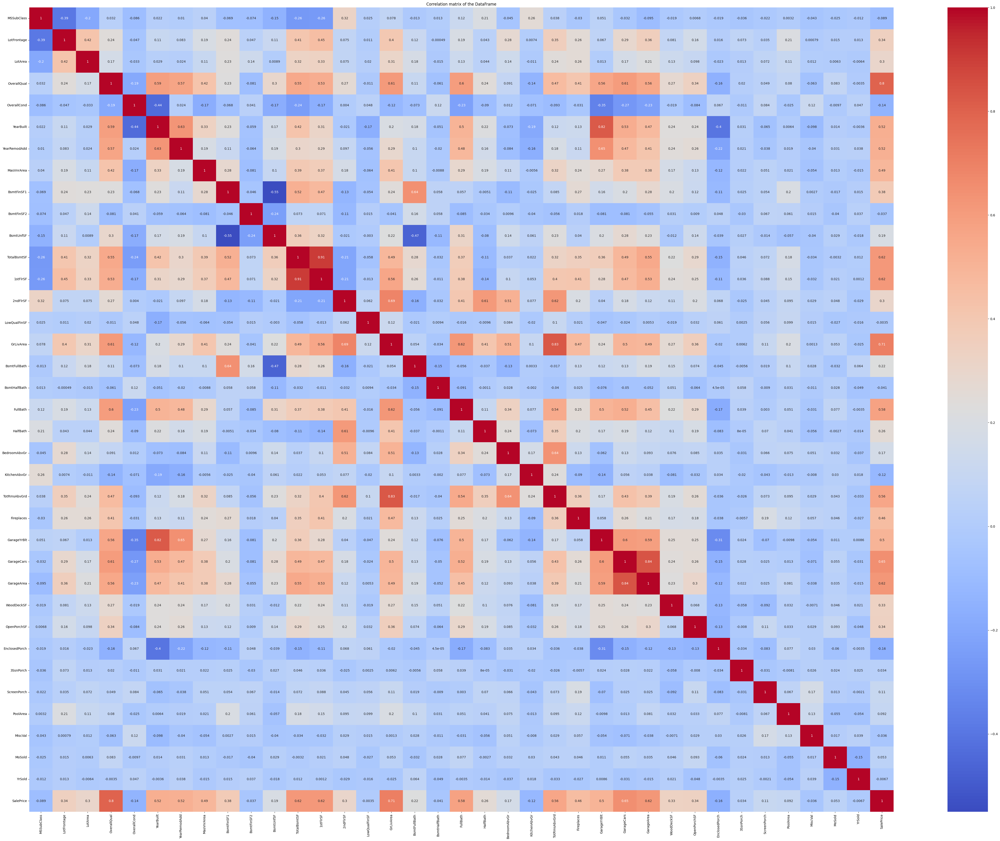

In [52]:
plt.figure(figsize=(60, 45)) # Increase the size of the heatmap for better visibility
sns.heatmap(numeric_correlation_matrix, cmap='coolwarm', annot=True)

plt.title('Correlation matrix of the DataFrame')
plt.show()

In [53]:
# Now let us perform linear regression 
LR = LinearRegression()
# First construct predictor variables (X) and target variables (Y)
X = non_null_data.drop('SalePrice', axis=1)
y = non_null_data['SalePrice']

# Split the training and test data (setting random state ensures we get same data, test size 0.3 means we are doing a 3:7 split)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=100)

# Train the model
LR.fit(X_train, y_train)

# Predict
y_pred = LR.predict(X_test)

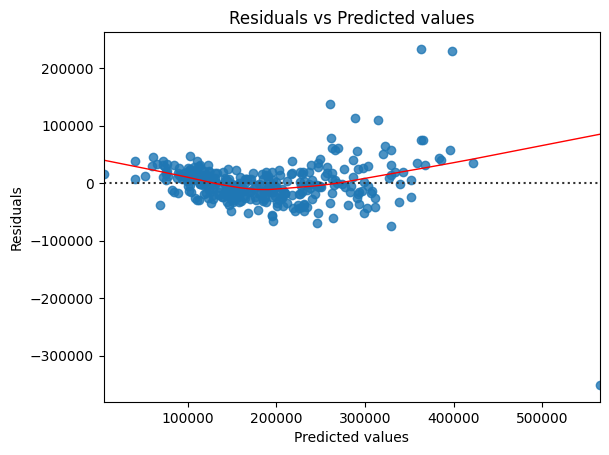

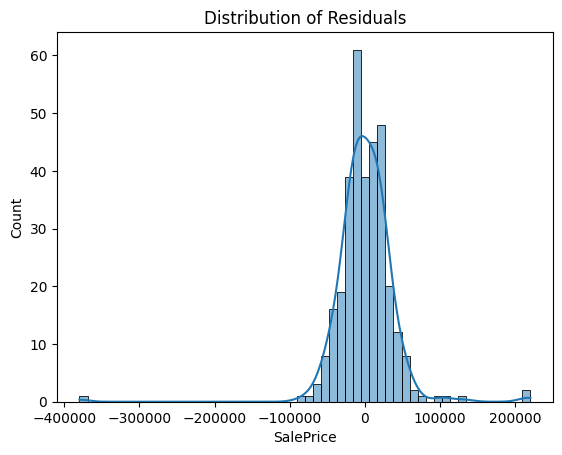

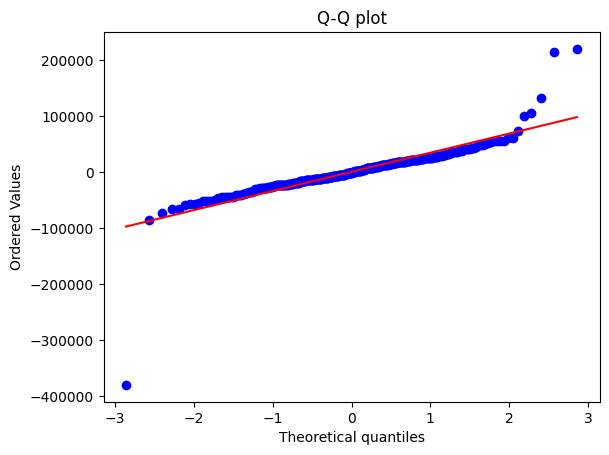

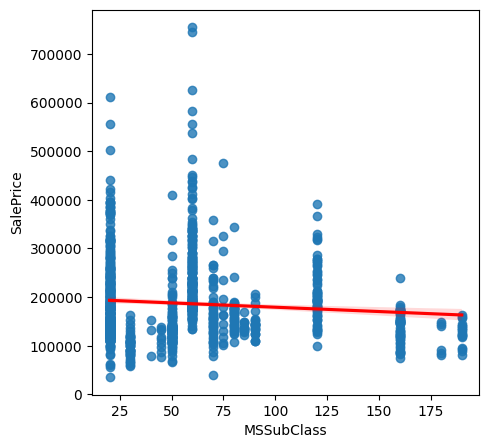

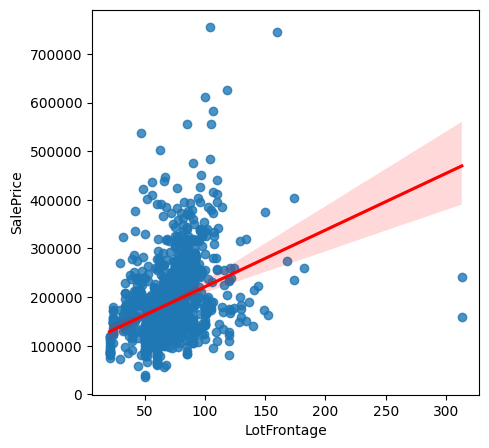

...

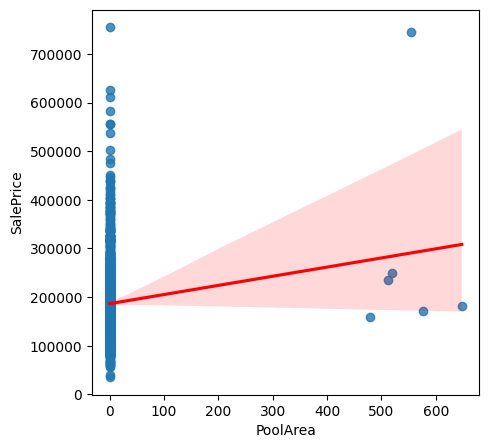

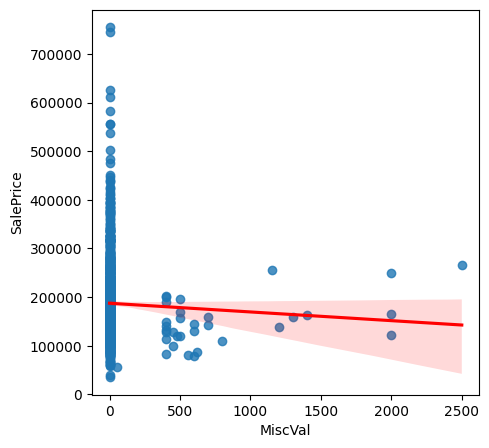

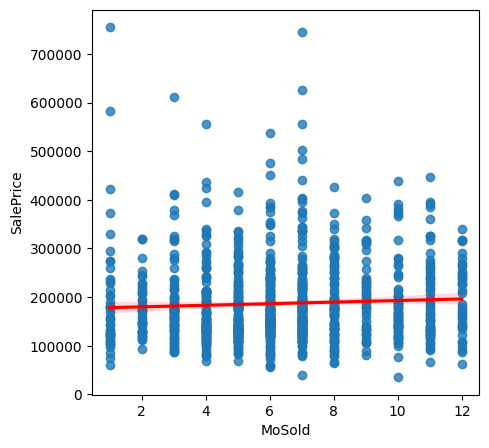

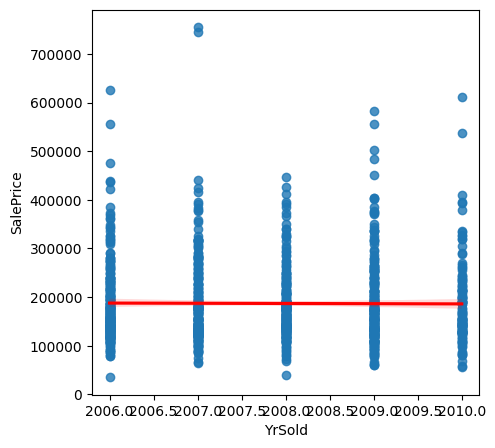

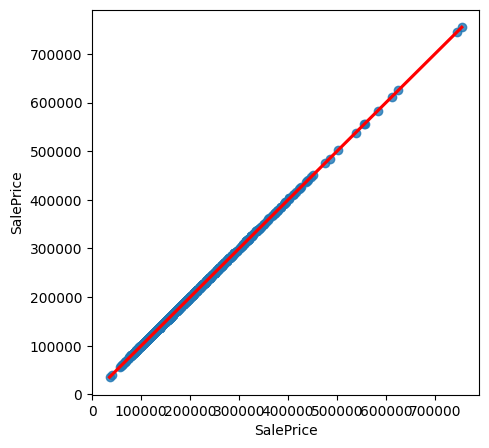

In [59]:
# Now let us plot the residuals 
residuals = y_test - y_pred
sns.residplot(x=y_pred, y=residuals, lowess=True, line_kws={'color': 'red', 'lw': 1, 'alpha': 1})
plt.xlabel('Predicted values')
plt.ylabel('Residuals')
plt.title('Residuals vs Predicted values')
plt.show()

# Histplot 
sns.histplot(residuals, kde=True)
plt.title('Distribution of Residuals')
plt.show()

# Q-Q plot
stats.probplot(residuals, dist="norm", plot=plt)
plt.title('Q-Q plot')
plt.show()

# It doesn't seem like all assumptions of linear regression are satisfied so let us look at regplots 
for column in non_null_data.columns:
    plt.figure(figsize=(5,5))
    sns.regplot(x=column, y='SalePrice', data=non_null_data, line_kws={'color': 'red'})
    plt.show()

In [60]:
# First let us get the R^2 score for the model 
r_sq = LR.score(X_test, y_test)
print(r_sq)

0.7821728780634338


It is clear to see that:


*   The predictive capabilities are relatively very low, only 78%
*   We can now move to Ridge and Lasso regression



In [61]:
# The value is about 77%, this implies only about 77% of the test data is predictable by training data. 
# We can see distribution of residual is mostly normal with some left skew but it is also very clear
# that residuals are not uniformly distributed along the 0 line and there are definite outliers. 

# As a first step we'll perform Ridge regression to see how much does the r^2 value changes. 
X = non_null_data.drop(columns=['SalePrice'])
y = non_null_data['SalePrice']

# It's a good practice to scale your data for Ridge regression
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=100)

# Create a Ridge regression object
ridge = Ridge(alpha=1.0)

# Train the model
ridge.fit(X_train, y_train)

# Print out the R^2 for the model against the full dataset
print(f'R^2 score: {ridge.score(X_test, y_test)}')


R^2 score: 0.7830911483144246


In [65]:
# With an alpha value of 1 the r^2 score is worse than linear regression, so let us do cross validation and see
# if we can choose any reasonable alpha values.
l_alphas = np.linspace(0.001, 10, 50)
l_alphas
# Create a RidgeCV regression object
ridgecv = RidgeCV(alphas=l_alphas)
ridgecv.fit(X_train, y_train)
# Print out the R^2 for the model against the full dataset
print(f'Optimal alpha: {ridgecv.alpha_}')
print(f'R^2 score: {ridgecv.score(X_test, y_test)}')
print("RidgeCV coefficients: \n", ridgecv.coef_)

Optimal alpha: 10.0
R^2 score: 0.7854797623416716
RidgeCV coefficients: 
 [-8132.35745054 -4009.81506144  4979.98850043 26220.42296929
  5851.65075169  9193.71463916  2290.2543671   6738.29252828
  4716.53927565  -151.70463313 -1499.41169637  3650.71006523
  8953.73756708 11597.41463467   615.06156437 16329.49199919
  5452.7937281   1165.80675119  2935.45721986 -2108.40436012
 -7373.71671886 -4655.40190256  6573.42821942   562.9500275
 -1088.34810034 11741.8184551   -721.45799767  2560.50488491
   711.38252947   795.82443522  1623.03404622  3649.9861986
 -2097.86948481  -592.78086369   -55.50361974  -249.10251401]


The value doesn't substantially improve with ridge regression. We next try lasso.

In [64]:
# Let us move to lasso since Ridge actually doesn't give anything better than normal linear regression.

# Define your predictor variables and target variable
X = non_null_data.drop('SalePrice', axis=1)
y = non_null_data['SalePrice']

# Scaling the data
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=100)

from sklearn.model_selection import GridSearchCV

# Define your parameters to optimize
param_grid = {
    'alpha': np.logspace(-4, -0.5, 30),
    'tol': [0.0001, 0.001, 0.01, 0.1],
    'max_iter': [1000, 2000, 3000, 4000, 5000]
}

# Create a base model
lasso = Lasso()

# Instantiate the grid search model
grid_search = GridSearchCV(estimator=lasso, param_grid=param_grid, 
                           cv=5, n_jobs=-1, verbose=2)

# Fit the grid search to the data
grid_search.fit(X_train, y_train)

# Print the best parameters
print(grid_search.best_params_)

# You can also get the best estimator directly
best_lasso_model = grid_search.best_estimator_

# And use it to make predictions
predictions = best_lasso_model.predict(X_test)

# Calculate the R^2 score
r2_score = best_lasso_model.score(X_test, y_test)
print("R^2 Score: ", r2_score)

Fitting 5 folds for each of 600 candidates, totalling 3000 fits
{'alpha': 0.31622776601683794, 'max_iter': 1000, 'tol': 0.01}
R^2 Score:  0.7828039967421373
